# Simulasi Random Walk untuk prediksi harga saham NVIDIA (NVDA)

# Import Library

In [11]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import yfinance as yf
from matplotlib.ticker import MultipleLocator, FuncFormatter, ScalarFormatter
import seaborn as sns
from datetime import datetime
import scipy.stats as stats
from sklearn.linear_model import LinearRegression
import matplotlib.cm as cm 
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

%matplotlib inline
sns.set_theme(style="whitegrid")
plt.rcParams["figure.figsize"] = (12, 6)

# Import Data NVDA

In [12]:
simbol_saham = "NVDA"
tanggal_mulai = "2025-01-01"
tanggal_akhir = "2025-12-24" 

data_mentah = yf.download(simbol_saham, start=tanggal_mulai, end=tanggal_akhir)

if isinstance(data_mentah.columns, pd.MultiIndex):
    data_mentah.columns = data_mentah.columns.get_level_values(0)

print(">>> Kolom yang tersedia:", data_mentah.columns.tolist())

[*********************100%***********************]  1 of 1 completed

>>> Kolom yang tersedia: ['Close', 'High', 'Low', 'Open', 'Volume']


# Fungsi Animasi Chart

In [13]:
def buat_animasi_chart(hasil_simulasi, judul="Simulasi"):
    fig, ax = plt.subplots(figsize=(12, 6))
    
    ax.set_xlim(0, hari_simulasi)
    ax.set_ylim(np.min(hasil_simulasi), np.max(hasil_simulasi))
    ax.set_title(f"Animasi: {judul}", fontsize=14, fontweight='bold')
    ax.set_xlabel("Hari")
    ax.set_ylabel("Harga (USD)")
    ax.yaxis.set_major_formatter(FuncFormatter(lambda x, p: f"${x:.0f}"))
    
    jalur_rainbow = [ax.plot([], [], lw=1, alpha=0.5, color=c)[0] for c in cm.rainbow(np.linspace(0, 1, 50))]
    garis_median, = ax.plot([], [], color='navy', lw=3, label='Median')
    
    def init():
        for line in jalur_rainbow:
            line.set_data([], [])
        garis_median.set_data([], [])
        return jalur_rainbow + [garis_median]

    def update(frame):
        x = np.arange(frame)
        for i, line in enumerate(jalur_rainbow):
            if i*20 < hasil_simulasi.shape[1]:
                line.set_data(x, hasil_simulasi[:frame, i*20]) 
        y_median = np.median(hasil_simulasi[:frame, :], axis=1)
        garis_median.set_data(x, y_median)
            
        return jalur_rainbow + [garis_median]

    ani = FuncAnimation(fig, update, frames=np.arange(1, hari_simulasi, 2), 
                        init_func=init, blit=True, interval=50)
    plt.close() 
    return HTML(ani.to_jshtml())

#  Data cleaning

In [14]:
if 'Adj close' in data_mentah.columns:
    kolom_target = 'Adj close'
elif 'Close' in data_mentah.columns:
    kolom_target = 'Close'
else:
    kolom_target = data_mentah.columns[0]

data_bersih = data_mentah.fillna(method = 'ffill')

jumlah_nan = data_bersih[kolom_target].isnull().sum()
if jumlah_nan == 0:
    print("Data sudah bersih")
else:
    print("Data masih ada NaN")

if (data_bersih[kolom_target] <= 0).any():
    print("Data masih ada nilai negatif")
else:
    print("Data sudah bersih")

Data sudah bersih
Data sudah bersih


C:\Users\jmjur\AppData\Local\Temp\ipykernel_9704\1639864144.py:8: FutureWarning: DataFrame.fillna with 'method' is deprecated and will raise in a future version. Use obj.ffill() or obj.bfill() instead.
  data_bersih = data_mentah.fillna(method = 'ffill')


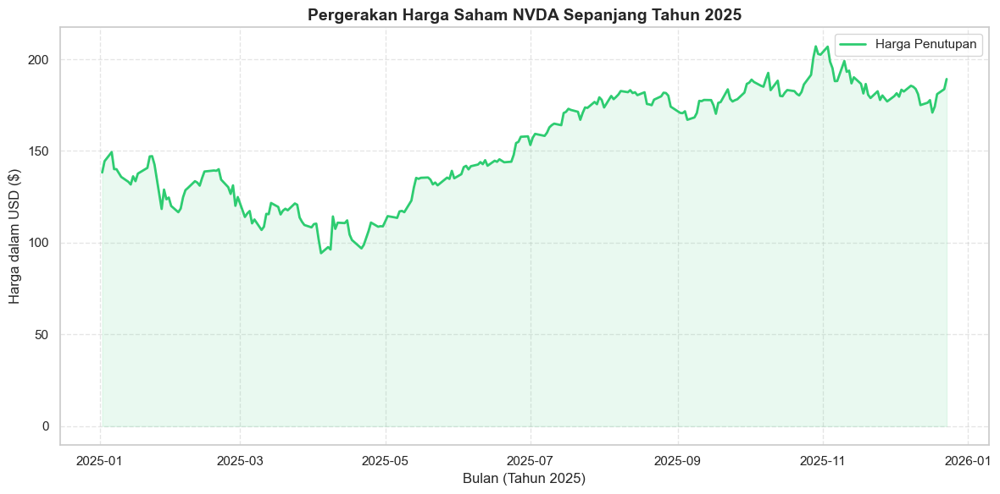

In [15]:
plt.figure(figsize=(12, 6))

plt.plot(data_bersih.index, data_bersih[kolom_target], color='#2ecc71', linewidth=2, label='Harga Penutupan')
plt.title(f"Pergerakan Harga Saham {simbol_saham} Sepanjang Tahun 2025", fontsize=14, fontweight='bold')
plt.xlabel("Bulan (Tahun 2025)", fontsize=12)
plt.ylabel("Harga dalam USD ($)", fontsize=12)
plt.fill_between(data_bersih.index, data_bersih[kolom_target], color='#2ecc71', alpha=0.1) # Efek shading bawah
plt.grid(True, linestyle='--', alpha=0.5)
plt.legend()

plt.tight_layout()
plt.show()

=== Hasil Ekstraksi Data Historis NVDA 2025 ===
Drift (mu)      : 0.001785 (Rata-rata arah pergerakan harian)
Volatility (sigma): 0.031564 (Tingkat risiko/keliaran acak)


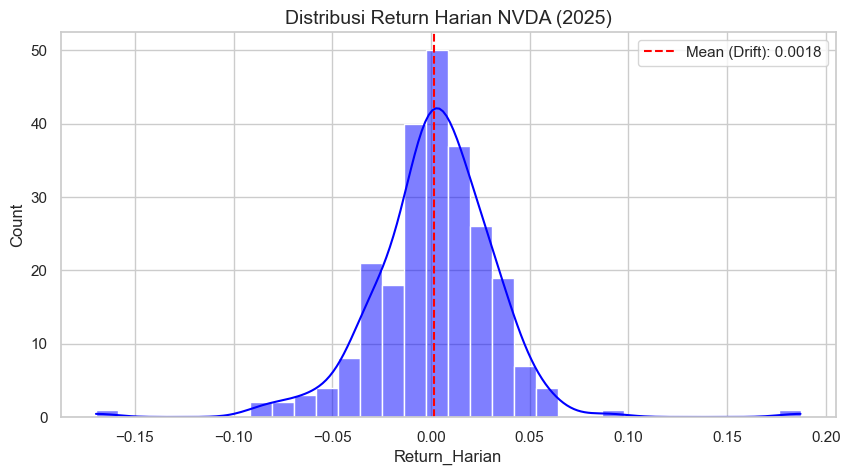

In [16]:
data_bersih['Return_Harian'] = data_bersih[kolom_target].pct_change()

mu = data_bersih['Return_Harian'].mean()

sigma = data_bersih['Return_Harian'].std()

print(f"=== Hasil Ekstraksi Data Historis {simbol_saham} 2025 ===")
print(f"Drift (mu)      : {mu:.6f} (Rata-rata arah pergerakan harian)")
print(f"Volatility (sigma): {sigma:.6f} (Tingkat risiko/keliaran acak)")

plt.figure(figsize=(10, 5))
sns.histplot(data_bersih['Return_Harian'].dropna(), kde=True, color='blue')
plt.title(f"Distribusi Return Harian {simbol_saham} (2025)", fontsize=14)
plt.axvline(mu, color='red', linestyle='--', label=f'Mean (Drift): {mu:.4f}')
plt.legend()
plt.show()

# Implementasi Model (GBM)

 Fungsi untuk menjalankan simulasi Random Walk (GBM) sebanyak N-kali.
    
    Input:
    - harga_awal: Harga saham hari ini (USD)
    - hari: Durasi simulasi ke depan (misal 30 hari)
    - jumlah_simulasi: Banyaknya jalur/paths (misal 1000)
    - mu: Drift harian (Tren)
    - sigma: Volatilitas harian (Keliaran)

    Rumus Geometric Brownian Motion (Random Walk Finansial)
    S(t) = S(t-1) * exp((mu - 0.5 * sigma^2) * dt + sigma * sqrt(dt) * Z)
    Karena dt kita adalah harian (1 hari), maka dt = 1

In [17]:
def jalankan_simulasi_saham(harga_awal, hari, jumlah_simulasi, mu, sigma):
    hasil_simulasi = np.zeros((hari, jumlah_simulasi))
    hasil_simulasi[0] = harga_awal
    
    for t in range(1, hari):
    
        Z = np.random.standard_normal(jumlah_simulasi)
        faktor_pengali = np.exp((mu - 0.5 * sigma**2) + (sigma * Z))
        hasil_simulasi[t] = hasil_simulasi[t-1] * faktor_pengali
        
    return hasil_simulasi

# Baseline Model

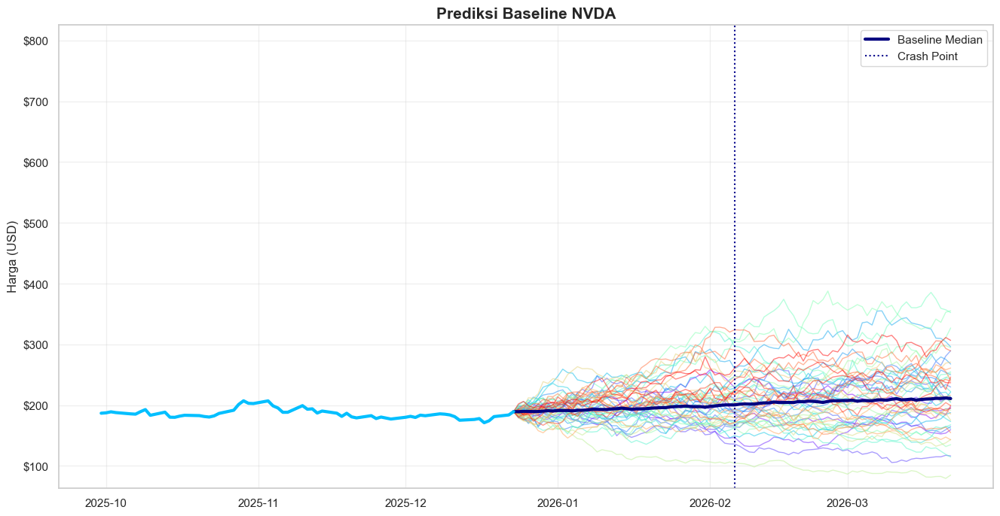

=== STATISTIK BASELINE ===
Harga Terakhir            : $189.21
Rata-rata Harga Akhir      : $221.73
Harga Tertinggi            : $731.39
Harga Terendah             : $84.72
Rentang Kepercayaan 90%    : $129.87 - $338.84
Potensi Kenaikan Maksimal  : +286.55%
Potensi Kenaikan Rata-rata : +17.19%
Potensi Return Maksimal    : +286.55%
Potensi Return Median      : +11.35%
Potensi Penurunan Maksimal : -55.22%
Potensi Penurunan Rata-rata: -16.84%
Probabilitas Harga NAIK    : 66.10%
Probabilitas Harga TURUN   : 33.90%


In [18]:
hari_simulasi = 90
jumlah_jalur = 1000
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_masa_depan = pd.date_range(start=data_bersih.index[-1], periods=hari_simulasi)

hasil_baseline = jalankan_simulasi_saham(harga_terakhir, hari_simulasi, jumlah_jalur, mu, sigma)

median_base = np.median(hasil_baseline, axis=1)
p5_base, p95_base = np.percentile(hasil_baseline, 5, axis=1), np.percentile(hasil_baseline, 95, axis=1)

plt.figure(figsize=(16, 8))
plt.plot(data_bersih.tail(60).index, data_bersih[kolom_target].tail(60), color='#00BFFF', lw=3, zorder=10)

colors = cm.rainbow(np.linspace(0, 1, 50))
for i in range(50):
    plt.plot(tanggal_masa_depan, hasil_baseline[:, i*20], color=colors[i], lw=1, alpha=0.5)

plt.plot(tanggal_masa_depan, median_base, color='navy', lw=3, label='Baseline Median')
plt.axvline(tanggal_masa_depan[45], color='darkblue', ls=':', label='Crash Point')
y_max = max(data_bersih[kolom_target].max(), hasil_baseline.max())
plt.ylim(bottom=min(data_bersih[kolom_target].min(), hasil_baseline.min()) * 0.8, top=y_max * 1.1) 

plt.title(f"Prediksi Baseline {simbol_saham}", fontsize=15, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.ylabel('Harga (USD)')

plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, p: f'${x:.0f}'))

plt.show()

harga_akhir_base = hasil_baseline[-1, :]
print(f"=== STATISTIK BASELINE ===")
print(f"Harga Terakhir            : ${harga_terakhir:.2f}")
print(f"Rata-rata Harga Akhir      : ${np.mean(harga_akhir_base):.2f}")
print(f"Harga Tertinggi            : ${np.max(harga_akhir_base):.2f}")
print(f"Harga Terendah             : ${np.min(harga_akhir_base):.2f}")
print(f"Rentang Kepercayaan 90%    : ${np.percentile(harga_akhir_base, 5):.2f} - ${np.percentile(harga_akhir_base, 95):.2f}")
print(f"Potensi Kenaikan Maksimal  : {((np.max(harga_akhir_base)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Kenaikan Rata-rata : {((np.mean(harga_akhir_base)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Maksimal    : {((np.max(harga_akhir_base)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Median      : {((np.median(harga_akhir_base)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Maksimal : {((np.min(harga_akhir_base)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Rata-rata: {((np.mean(harga_akhir_base[harga_akhir_base < harga_terakhir])/harga_terakhir)-1)*100 if any(harga_akhir_base < harga_terakhir) else 0:+.2f}%")
print(f"Probabilitas Harga NAIK    : {np.mean(harga_akhir_base > harga_terakhir)*100:.2f}%")
print(f"Probabilitas Harga TURUN   : {np.mean(harga_akhir_base < harga_terakhir)*100:.2f}%")

In [19]:
buat_animasi_chart(hasil_baseline, "Baseline Skenario")

# Black Swan Skenario

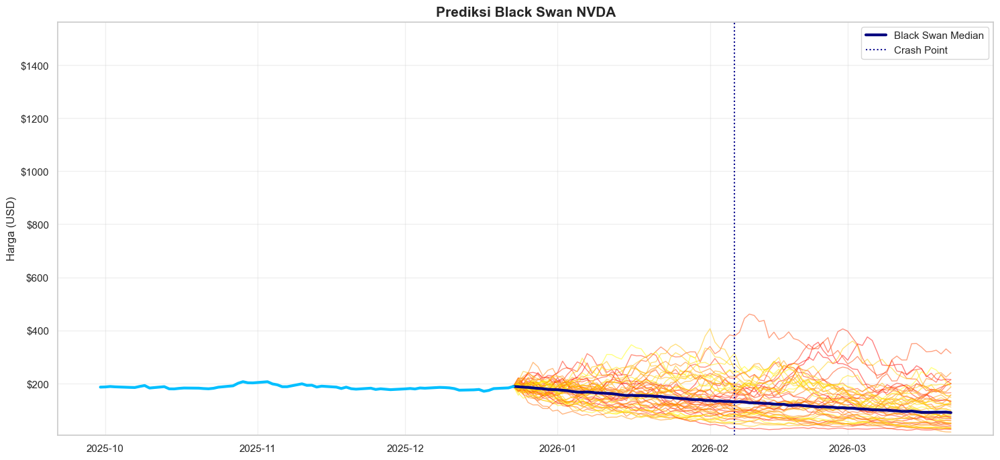

=== RINGKASAN STATISTIK: BLACK SWAN ===
Current Price               : $189.21


NameError: name 'harga_akhir_bs' is not defined

In [20]:
hari_simulasi = 90
jumlah_jalur = 1000
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_masa_depan = pd.date_range(start=data_bersih.index[-1], periods=hari_simulasi)
mu_bs, sigma_bs = -0.005, sigma * 2.5

hasil_black_swan = jalankan_simulasi_saham(harga_terakhir, hari_simulasi, jumlah_jalur, mu_bs, sigma_bs)

median_bs = np.median(hasil_black_swan, axis=1)
p5_bs, p95_bs = np.percentile(hasil_black_swan, 5, axis=1), np.percentile(hasil_black_swan, 95, axis=1)

plt.figure(figsize=(18, 8))
plt.plot(data_bersih.tail(60).index, data_bersih[kolom_target].tail(60), color='#00BFFF', lw=3, zorder=10)
colors = cm.autumn(np.linspace(0, 1, 50))
for i in range(50):
    plt.plot(tanggal_masa_depan, hasil_black_swan[:, i*20], color=colors[i], lw=1, alpha=0.5)
plt.plot(tanggal_masa_depan, median_bs, color='navy', lw=3, label='Black Swan Median')
plt.axvline(tanggal_masa_depan[45], color='darkblue', ls=':', label='Crash Point')
y_min_val = min(data_bersih[kolom_target].min(), hasil_black_swan.min())
y_max_val = max(data_bersih[kolom_target].max(), hasil_black_swan.max())
plt.ylim(bottom=y_min_val * 0.8, top=y_max_val * 1.1)
plt.title(f'Prediksi Black Swan {simbol_saham}', fontsize=15, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.ylabel('Harga (USD)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, p: f'${x:.0f}'))
plt.show()

harga_akhir_bs = hasil_black_swan[-1, :]
print(f"=== RINGKASAN STATISTIK: BLACK SWAN ===")
print(f"Current Price               : ${harga_terakhir:.2f}")
print(f"Rata-rata Harga Akhir       : ${np.mean(harga_akhir_bs):.2f}")
print(f"Harga Tertinggi             : ${np.max(harga_akhir_bs):.2f}")
print(f"Harga Terendah              : ${np.min(harga_akhir_bs):.2f}")
print(f"Rentang Kepercayaan 90%     : ${np.percentile(harga_akhir_bs, 5):.2f} - ${np.percentile(harga_akhir_bs, 95):.2f}")
print(f"Potensi Kenaikan Maksimal   : {((np.max(harga_akhir_bs)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Kenaikan Rata-rata  : {((np.mean(harga_akhir_bs)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Maksimal     : {((np.max(harga_akhir_bs)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Median       : {((np.median(harga_akhir_bs)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Maksimal  : {((np.min(harga_akhir_bs)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Rata-rata : {((np.mean(harga_akhir_bs[harga_akhir_bs < harga_terakhir])/harga_terakhir)-1)*100 if any(harga_akhir_bs < harga_terakhir) else 0:+.2f}%")
print(f"Probabilitas Harga Naik     : {np.mean(harga_akhir_bs > harga_terakhir) * 100:.2f}%")
print(f"Probabilitas Harga TURUN    : {np.mean(harga_akhir_bs < harga_terakhir)*100:.2f}%")

In [ ]:
buat_animasi_chart(hasil_black_swan, "Market Crash Skenario")

# AI Winter Skenario

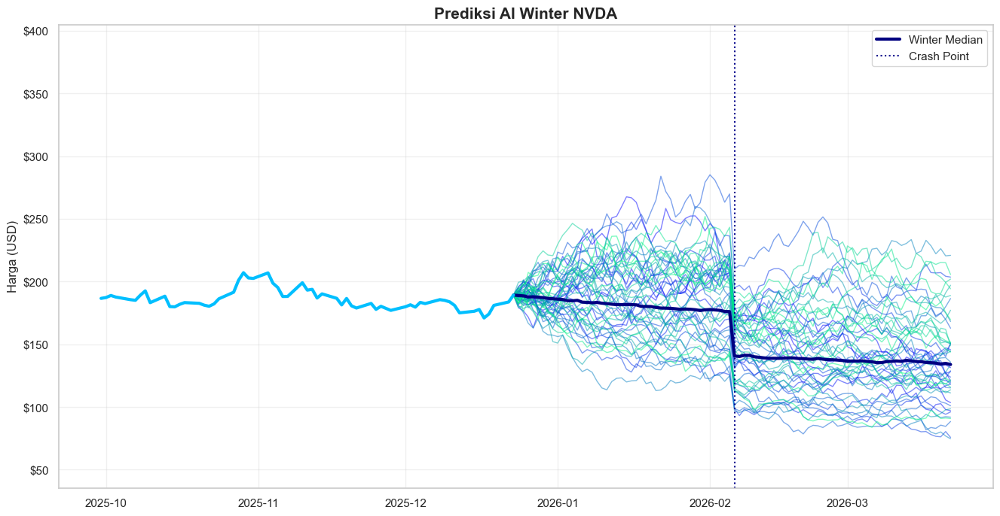

=== RINGKASAN STATISTIK: AI WINTER ===
Current Price              : $189.21
Rata-rata Harga Akhir      : $139.04
Harga Tertinggi            : $375.63
Harga Terendah             : $60.11
Rentang Kepercayaan 90%    : $80.40 - $215.07
Potensi Kenaikan Maksimal  : +98.53%
Potensi Kenaikan Rata-rata : -26.51%
Potensi Return Maksimal    : +98.53%
Potensi Return Median      : -28.91%
Potensi Penurunan Maksimal : -68.23%
Potensi Penurunan Rata-rata: -31.85%
Probabilitas Harga Turun   : 89.00%
Probabilitas Harga NAIK    : 11.00%


In [ ]:
hari_simulasi = 90
jumlah_jalur = 1000
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_masa_depan = pd.date_range(start=data_bersih.index[-1], periods=hari_simulasi)

hasil_ai_winter = jalankan_simulasi_saham(harga_terakhir, hari_simulasi, jumlah_jalur, -0.001, sigma)
hasil_ai_winter[45:] = hasil_ai_winter[45:] * 0.80 

median_winter = np.median(hasil_ai_winter, axis=1)

plt.figure(figsize=(16, 8))
plt.plot(data_bersih.tail(60).index, data_bersih[kolom_target].tail(60), color='#00BFFF', lw=3, zorder=10)
colors = cm.winter(np.linspace(0, 1, 50))
for i in range(50):
    plt.plot(tanggal_masa_depan, hasil_ai_winter[:, i*20], color=colors[i], lw=1, alpha=0.5)
plt.plot(tanggal_masa_depan, median_winter, color='navy', lw=3, label='Winter Median')
plt.axvline(tanggal_masa_depan[45], color='darkblue', ls=':', label='Crash Point')
y_min_val = min(data_bersih[kolom_target].min(), hasil_ai_winter.min())
y_max_val = max(data_bersih[kolom_target].max(), hasil_ai_winter.max())
plt.ylim(bottom=y_min_val * 0.8, top=y_max_val * 1.1)
plt.title(f'Prediksi AI Winter {simbol_saham}', fontsize=15, fontweight='bold')
plt.legend()
plt.grid(True, alpha=0.3)
plt.ylabel('Harga (USD)')
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, p: f'${x:.0f}'))
plt.show()
print(f"=== RINGKASAN STATISTIK: AI WINTER ===")
print(f"Current Price              : ${harga_terakhir:.2f}")
print(f"Rata-rata Harga Akhir      : ${np.mean(harga_akhir_aiw):.2f}")
print(f"Harga Tertinggi            : ${np.max(harga_akhir_aiw):.2f}")
print(f"Harga Terendah             : ${np.min(harga_akhir_aiw):.2f}")
print(f"Rentang Kepercayaan 90%    : ${np.percentile(harga_akhir_aiw, 5):.2f} - ${np.percentile(harga_akhir_aiw, 95):.2f}")
print(f"Potensi Kenaikan Maksimal  : {((np.max(harga_akhir_aiw)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Kenaikan Rata-rata : {((np.mean(harga_akhir_aiw)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Maksimal    : {((np.max(harga_akhir_aiw)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Median      : {((np.median(harga_akhir_aiw)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Maksimal : {((np.min(harga_akhir_aiw)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Rata-rata: {((np.mean(harga_akhir_aiw[harga_akhir_aiw < harga_terakhir])/harga_terakhir)-1)*100 if any(harga_akhir_aiw < harga_terakhir) else 0:+.2f}%")
print(f"Probabilitas Harga Turun   : {np.mean(harga_akhir_aiw < harga_terakhir)*100:.2f}%")
print(f"Probabilitas Harga NAIK    : {np.mean(harga_akhir_aiw > harga_terakhir)*100:.2f}%")

In [ ]:
buat_animasi_chart(hasil_ai_winter, "Market Crash Winter AI Skenario")

# Super Bullish (Naik) Skenario

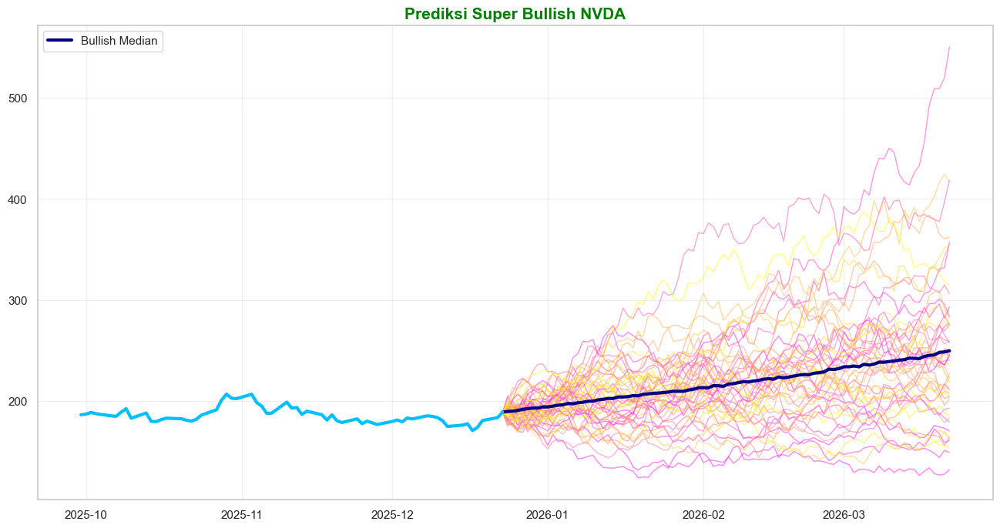

=== RINGKASAN STATISTIK: SUPER BULLISH ===
Current Price              : $189.21
Rata-rata Harga Akhir      : $259.30
Harga Tertinggi            : $579.84
Harga Terendah             : $96.68
Rentang Kepercayaan 90%    : $155.04 - $406.54
Potensi Kenaikan Maksimal  : +206.45%
Potensi Kenaikan Rata-rata : +37.05%
Potensi Return Maksimal    : +206.45%
Potensi Return Median      : +32.04%
Potensi Penurunan Maksimal : -48.90%
Potensi Penurunan Rata-rata: -13.85%
Probabilitas Harga NAIK    : 82.90%
Probabilitas Harga TURUN   : 17.10%


In [ ]:
hari_simulasi = 90
jumlah_jalur = 1000
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_masa_depan = pd.date_range(start=data_bersih.index[-1], periods=hari_simulasi)
mu_bull = mu * 2

hasil_bullish = jalankan_simulasi_saham(harga_terakhir, hari_simulasi, jumlah_jalur, mu_bull, sigma)

median_bull = np.median(hasil_bullish, axis=1)

plt.figure(figsize=(16, 8))
plt.plot(data_bersih.tail(60).index, data_bersih[kolom_target].tail(60), color='#00BFFF', lw=3, zorder=10)
colors = cm.spring(np.linspace(0, 1, 50))
for i in range(50):
    plt.plot(tanggal_masa_depan, hasil_bullish[:, i*20], color=colors[i], lw=1, alpha=0.5)
plt.plot(tanggal_masa_depan, median_bull, color='navy', lw=3, label='Bullish Median')
plt.title(f"Prediksi Super Bullish {simbol_saham}", fontsize=15, fontweight='bold', color='green'); plt.legend(); plt.grid(True, alpha=0.3)
plt.show()

harga_akhir_bull = hasil_bullish[-1, :]
print(f"=== RINGKASAN STATISTIK: SUPER BULLISH ===")
print(f"Current Price              : ${harga_terakhir:.2f}")
print(f"Rata-rata Harga Akhir      : ${np.mean(harga_akhir_bull):.2f}")
print(f"Harga Tertinggi            : ${np.max(harga_akhir_bull):.2f}")
print(f"Harga Terendah             : ${np.min(harga_akhir_bull):.2f}")
print(f"Rentang Kepercayaan 90%    : ${np.percentile(harga_akhir_bull, 5):.2f} - ${np.percentile(harga_akhir_bull, 95):.2f}")
print(f"Potensi Kenaikan Maksimal  : {((np.max(harga_akhir_bull)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Kenaikan Rata-rata : {((np.mean(harga_akhir_bull)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Maksimal    : {((np.max(harga_akhir_bull)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Median      : {((np.median(harga_akhir_bull)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Maksimal : {((np.min(harga_akhir_bull)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Rata-rata: {((np.mean(harga_akhir_bull[harga_akhir_bull < harga_terakhir])/harga_terakhir)-1)*100 if any(harga_akhir_bull < harga_terakhir) else 0:+.2f}%")
print(f"Probabilitas Harga NAIK    : {np.mean(harga_akhir_bull > harga_terakhir)*100:.2f}%")
print(f"Probabilitas Harga TURUN   : {np.mean(harga_akhir_bull < harga_terakhir)*100:.2f}%")

# 1 Tahun Market Skenario

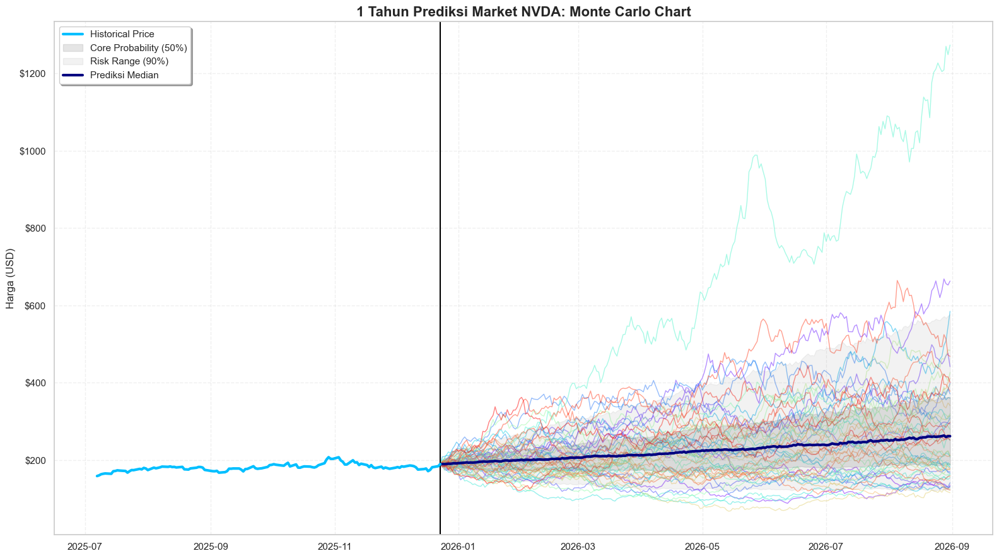

   ANALISIS PASAR (1 TAHUN) - NVDA
--- SENTIMEN & TREN ---
Current Price              : $189.21

--- PROBABILITAS HASIL ---
Potensi Kenaikan Maksimal  : +596.22%
Potensi Kenaikan Rata-rata : +55.02%
Potensi Return Maksimal    : +596.22%
Potensi Return Median      : +38.16%
Potensi Penurunan Maksimal : -64.04%
Potensi Penurunan Rata-rata: -22.13%
Probabilitas Harga NAIK    : 74.60%
Probabilitas Harga TURUN   : 25.40%
Rasio Naik/Turun           : 2.94x

--- RENTANG HARGA STATISTIK ---
Support Terkuat            : $122.49
Median Prediksi            : $261.41
Resistance Terkuat         : $577.08

--- STATISTIK HARGA AKHIR ---
Median Prediksi            : $261.41
Rentang Bawah              : $122.49
Rentang Atas               : $577.08
Tingkat Volatilitas        : 50.11% (Annualized)

--- KESIMPULAN INVESTASI ---
Estimasi Return Median     : +38.16%
Status Risiko              : Moderate Risk


In [ ]:
hari_setahun = 252 
jumlah_jalur = 1000
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_1y = pd.date_range(start=data_bersih.index[-1], periods=hari_setahun)

hasil_1y = jalankan_simulasi_saham(
    harga_terakhir, 
    hari_setahun, 
    jumlah_jalur, 
    mu, 
    sigma
)

median_path = np.median(hasil_1y, axis=1)
p5, p25, p75, p95 = [np.percentile(hasil_1y, q, axis=1) for q in [5, 25, 75, 95]]

plt.figure(figsize=(16, 9))
hist_data = data_bersih.tail(120)

plt.plot(hist_data.index, hist_data[kolom_target], color='#00BFFF', lw=3, label='Historical Price', zorder=10)

colors = cm.rainbow(np.linspace(0, 1, 50)) 
for i in range(50):
    plt.plot(tanggal_1y, hasil_1y[:, i*20], color=colors[i], lw=1, alpha=0.5, zorder=1)

plt.fill_between(tanggal_1y, p25, p75, color='gray', alpha=0.2, label='Core Probability (50%)', zorder=2)
plt.fill_between(tanggal_1y, p5, p95, color='gray', alpha=0.1, label='Risk Range (90%)', zorder=2)

plt.plot(tanggal_1y, median_path, color='navy', lw=3, label='Prediksi Median', zorder=4)

plt.title(f"1 Tahun Prediksi Market {simbol_saham}: Monte Carlo Chart", fontsize=16, fontweight='bold')
plt.ylabel("Harga (USD)")
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, p: f'${x:.0f}'))
plt.axvline(data_bersih.index[-1], color='black', lw=1.5, ls='-')
plt.grid(True, alpha=0.3, ls='--')
plt.legend(loc='upper left', frameon=True, shadow=True)
plt.tight_layout()
plt.show()

harga_akhir_1y = hasil_1y[-1, :]
prob_naik = np.mean(harga_akhir_1y > harga_terakhir) * 100
prob_turun = np.mean(harga_akhir_1y < harga_terakhir) * 100

print(f"=========================================================")
print(f"   ANALISIS PASAR (1 TAHUN) - {simbol_saham}")
print(f"=========================================================")
print(f"--- SENTIMEN & TREN ---")
print(f"Current Price              : ${harga_terakhir:.2f}")
print(f"\n--- PROBABILITAS HASIL ---")
print(f"Potensi Kenaikan Maksimal  : {((np.max(harga_akhir_1y)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Kenaikan Rata-rata : {((np.mean(harga_akhir_1y)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Maksimal    : {((np.max(harga_akhir_1y)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Return Median      : {((np.median(harga_akhir_1y)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Maksimal : {((np.min(harga_akhir_1y)/harga_terakhir)-1)*100:+.2f}%")
print(f"Potensi Penurunan Rata-rata: {((np.mean(harga_akhir_1y[harga_akhir_1y < harga_terakhir])/harga_terakhir)-1)*100 if any(harga_akhir_1y < harga_terakhir) else 0:+.2f}%")
print(f"Probabilitas Harga NAIK    : {prob_naik:.2f}%")
print(f"Probabilitas Harga TURUN   : {prob_turun:.2f}%")
print(f"Rasio Naik/Turun           : {prob_naik/prob_turun:.2f}x")

print(f"\n--- RENTANG HARGA STATISTIK ---")
print(f"Support Terkuat            : ${p5[-1]:.2f}")
print(f"Median Prediksi            : ${np.median(harga_akhir_1y):.2f}")
print(f"Resistance Terkuat         : ${p95[-1]:.2f}")

print(f"\n--- STATISTIK HARGA AKHIR ---")
print(f"Median Prediksi            : ${np.median(harga_akhir_1y):.2f}")
print(f"Rentang Bawah              : ${p5[-1]:.2f}")
print(f"Rentang Atas               : ${p95[-1]:.2f}")
print(f"Tingkat Volatilitas        : {sigma * np.sqrt(252) * 100:.2f}% (Annualized)")

print(f"\n--- KESIMPULAN INVESTASI ---")
return_ekspektasi = ((np.median(harga_akhir_1y)/harga_terakhir)-1)*100
print(f"Estimasi Return Median     : {return_ekspektasi:+.2f}%")
print(f"Status Risiko              : {'High Risk' if prob_turun > 30 else 'Moderate Risk'}")
print(f"=========================================================")

# Perbandingan 3 Skenario

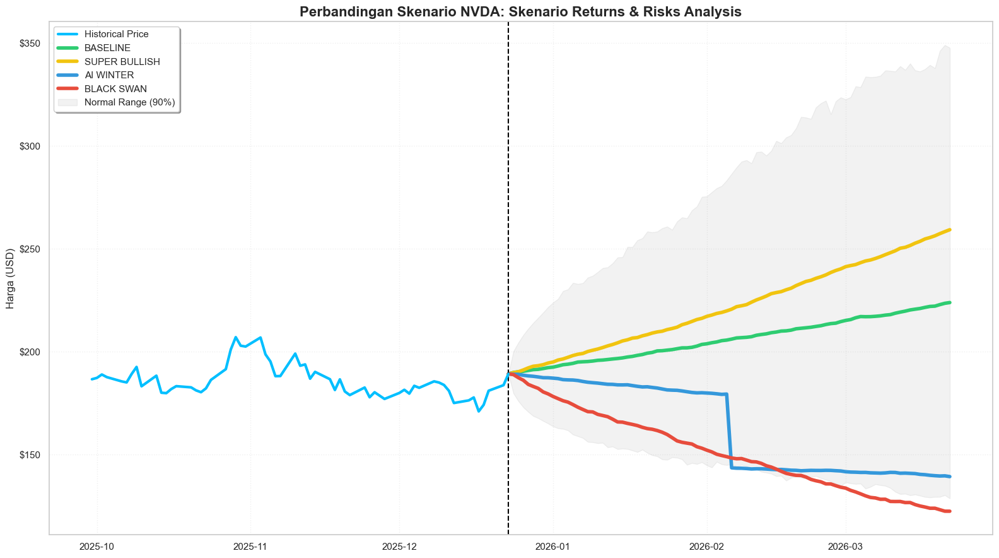

SKENARIO        | TARGET PRICE | EXP.RET   | MED.RET   | AVG.UP    | MAX.UP    | AVG.DOWN  | MAX.DOWN  | P.NAIK  | P.TURUN
--------------------------------------------------------------------------------------------------------------------------
Baseline        | $223.87      | +18.32%   | +12.90%   | +35.32%   | +200.18%  | -17.48%   | -68.78%   | 67.80%  | 32.20% 
Super Bullish   | $259.30      | +37.05%   | +32.04%   | +47.54%   | +206.45%  | -13.85%   | -48.90%   | 82.90%  | 17.10% 
AI Winter       | $139.23      | -26.42%   | -29.26%   | +16.52%   | +80.69%   | -32.27%   | -74.99%   | 12.00%  | 88.00% 
Black Swan      | $122.39      | -35.32%   | -50.62%   | +65.88%   | +1102.04% | -54.16%   | -95.50%   | 15.70%  | 84.30% 


In [ ]:
hari_simulasi = 90
harga_terakhir = data_bersih[kolom_target].iloc[-1]
tanggal_masa_depan = pd.date_range(start=data_bersih.index[-1], periods=hari_simulasi)

def get_battle_stats(hasil, nama):
    akhir = hasil[-1, :]
    
    target_price = np.mean(akhir)
    
    exp_return = ((target_price / harga_terakhir) - 1) * 100
    median_return = ((np.median(akhir) / harga_terakhir) - 1) * 100
    
    jalur_untung = akhir[akhir > harga_terakhir]
    avg_upside = ((np.mean(jalur_untung) / harga_terakhir) - 1) * 100 if len(jalur_untung) > 0 else 0
    
    jalur_rugi = akhir[akhir < harga_terakhir]
    avg_downside = ((np.mean(jalur_rugi) / harga_terakhir) - 1) * 100 if len(jalur_rugi) > 0 else 0
    
    max_up = ((np.max(akhir) / harga_terakhir) - 1) * 100
    max_down = ((np.min(akhir) / harga_terakhir) - 1) * 100
    
    p_naik = np.mean(akhir > harga_terakhir) * 100
    p_turun = np.mean(akhir < harga_terakhir) * 100
    
    return {
        "Skenario": nama,
        "Target": f"${target_price:.2f}",
        "Exp.Ret": f"{exp_return:+.2f}%",
        "Med.Ret": f"{median_return:+.2f}%",
        "Avg.Up": f"{avg_upside:+.2f}%",   
        "Max.Up": f"{max_up:+.2f}%",
        "Avg.Down": f"{avg_downside:+.2f}%",
        "Max.Down": f"{max_down:+.2f}%",
        "P.Naik": f"{p_naik:.2f}%",
        "P.Turun": f"{p_turun:.2f}%"
    }

plt.figure(figsize=(16, 9))
plt.plot(data_bersih.tail(60).index, data_bersih[kolom_target].tail(60), color='#00BFFF', lw=3, label='Historical Price', zorder=10)

plt.plot(tanggal_masa_depan, np.mean(hasil_baseline, axis=1), color='#2ecc71', lw=4, label='BASELINE')
plt.plot(tanggal_masa_depan, np.mean(hasil_bullish, axis=1), color='#f1c40f', lw=4, label='SUPER BULLISH')
plt.plot(tanggal_masa_depan, np.mean(hasil_ai_winter, axis=1), color='#3498db', lw=4, label='AI WINTER')
plt.plot(tanggal_masa_depan, np.mean(hasil_black_swan, axis=1), color='#e74c3c', lw=4, label='BLACK SWAN')

p5_base, p95_base = np.percentile(hasil_baseline, 5, axis=1), np.percentile(hasil_baseline, 95, axis=1)
plt.fill_between(tanggal_masa_depan, p5_base, p95_base, color='gray', alpha=0.1, label='Normal Range (90%)')

plt.title(f"Perbandingan Skenario {simbol_saham}: Skenario Returns & Risks Analysis", fontsize=16, fontweight='bold')
plt.ylabel("Harga (USD)")
plt.gca().yaxis.set_major_formatter(FuncFormatter(lambda x, p: f'${x:.0f}'))
plt.axvline(data_bersih.index[-1], color='black', lw=1.5, ls='--')
plt.grid(True, alpha=0.3, ls=':')
plt.legend(loc='upper left', frameon=True, shadow=True)
plt.tight_layout()
plt.show()

results = [
    get_battle_stats(hasil_baseline, "Baseline"),
    get_battle_stats(hasil_bullish, "Super Bullish"),
    get_battle_stats(hasil_ai_winter, "AI Winter"),
    get_battle_stats(hasil_black_swan, "Black Swan")
]

header = f"{'SKENARIO':<15} | {'TARGET PRICE':<12} | {'EXP.RET':<9} | {'MED.RET':<9} | {'AVG.UP':<9} | {'MAX.UP':<9} | {'AVG.DOWN':<9} | {'MAX.DOWN':<9} | {'P.NAIK':<7} | {'P.TURUN':<7}"
print(header)
print("-" * len(header))
for r in results:
    print(f"{r['Skenario']:<15} | {r['Target']:<12} | {r['Exp.Ret']:<9} | {r['Med.Ret']:<9} | {r['Avg.Up']:<9} | {r['Max.Up']:<9} | {r['Avg.Down']:<9} | {r['Max.Down']:<9} | {r['P.Naik']:<7} | {r['P.Turun']:<7}")

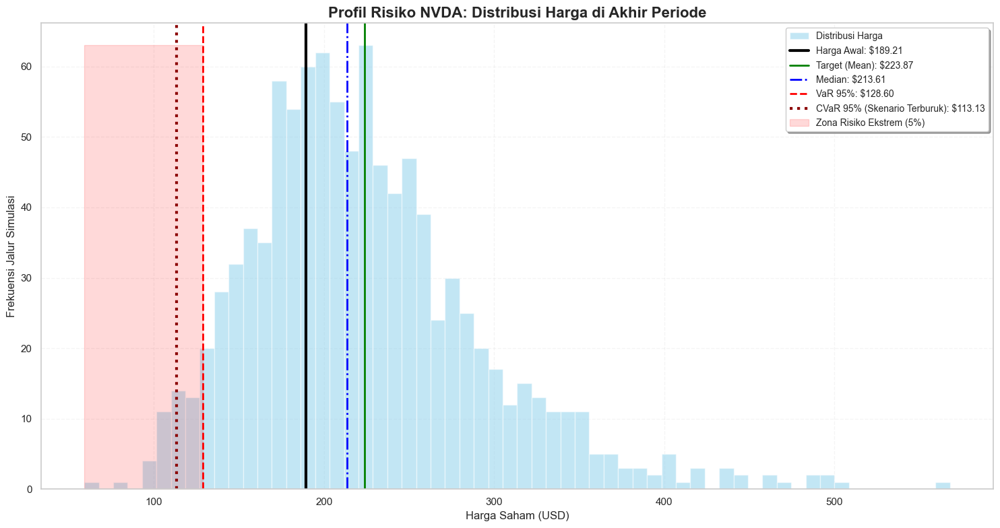

   LAPORAN MANAJEMEN RISIKO KUANTITATIF - NVDA
Harga Hari Ini (Awal)   : $189.21
Target Harga (Mean)     : $223.87 (+18.32%)
Titik Tengah (Median)   : $213.61 (+12.90%)
---------------------------------------------------------
Value at Risk (VaR 95%) : $128.60
Potensi Rugi Maksimal   : -32.04% (Keyakinan 95%)
---------------------------------------------------------
CVaR 95% (Avg. Sial)    : $113.13
Estimasi Rugi Terburuk  : -40.21% (Jika VaR terlampaui)


In [ ]:
harga_akhir = hasil_baseline[-1, :]
harga_awal = harga_terakhir

var_95 = np.percentile(harga_akhir, 5)           
cvar_95 = harga_akhir[harga_akhir <= var_95].mean() 
target_mean = np.mean(harga_akhir)               
titik_median = np.median(harga_akhir)             

plt.figure(figsize=(15, 8))

n, bins, patches = plt.hist(harga_akhir, bins=60, color='skyblue', alpha=0.5, edgecolor='white', label='Distribusi Harga')

plt.axvline(harga_awal, color='black', linestyle='-', lw=3, label=f'Harga Awal: ${harga_awal:.2f}')

plt.axvline(target_mean, color='green', linestyle='-', lw=2, label=f'Target (Mean): ${target_mean:.2f}')

plt.axvline(titik_median, color='blue', linestyle='-.', lw=2, label=f'Median: ${titik_median:.2f}')

plt.axvline(var_95, color='red', linestyle='--', lw=2, label=f'VaR 95%: ${var_95:.2f}')

plt.axvline(cvar_95, color='darkred', linestyle=':', lw=3, label=f'CVaR 95% (Skenario Terburuk): ${cvar_95:.2f}')

plt.fill_betweenx([0, n.max()], var_95, harga_akhir.min(), color='red', alpha=0.15, label='Zona Risiko Ekstrem (5%)')

plt.title(f"Profil Risiko {simbol_saham}: Distribusi Harga di Akhir Periode", fontsize=16, fontweight='bold')
plt.xlabel("Harga Saham (USD)", fontsize=12)
plt.ylabel("Frekuensi Jalur Simulasi", fontsize=12)
plt.grid(True, alpha=0.2, ls='--')
plt.legend(loc='upper right', frameon=True, shadow=True, fontsize=10)

plt.tight_layout()
plt.show()

print(f"=========================================================")
print(f"   LAPORAN MANAJEMEN RISIKO KUANTITATIF - {simbol_saham}")
print(f"=========================================================")
print(f"Harga Hari Ini (Awal)   : ${harga_awal:.2f}")
print(f"Target Harga (Mean)     : ${target_mean:.2f} ({((target_mean/harga_awal)-1)*100:+.2f}%)")
print(f"Titik Tengah (Median)   : ${titik_median:.2f} ({((titik_median/harga_awal)-1)*100:+.2f}%)")
print(f"---------------------------------------------------------")
print(f"Value at Risk (VaR 95%) : ${var_95:.2f}")
print(f"Potensi Rugi Maksimal   : {((var_95/harga_awal)-1)*100:.2f}% (Keyakinan 95%)")
print(f"---------------------------------------------------------")
print(f"CVaR 95% (Avg. Sial)    : ${cvar_95:.2f}")
print(f"Estimasi Rugi Terburuk  : {((cvar_95/harga_awal)-1)*100:.2f}% (Jika VaR terlampaui)")
print(f"=========================================================")